<a href="https://colab.research.google.com/github/sierralee51/Insaightful.ai/blob/main/Hackathon4_10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import necessary libraries


In [ ]:
!pip install fer
from fer import FER
import cv2
import dlib
from scipy.spatial import distance as dist
import math
import json
import numpy as np
from imutils import face_utils
from datetime import datetime, date
import matplotlib.pyplot as plt
import os
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import numpy as np
import PIL
import io
import html
import time



# Takes photo with webcam

In [ ]:


def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


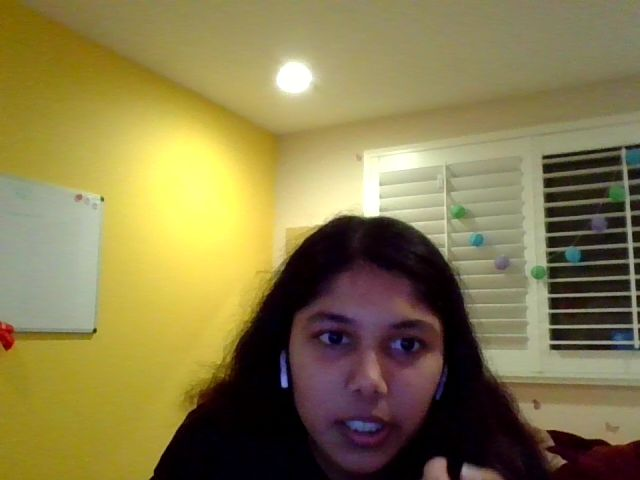

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

# Emotion detection using video or photo

In [ ]:
# Prompt for selecting video source
input_setting = input("Enter one of the option numbers [0 for Webcam, 1 for Video File, 2 for photo from webcam]: ")
if input_setting == "0":
    vid_src = 0
    
elif input_setting == "2":
  vid_src = "photo.jpg"
  stop_at = 1
else:
    vid_src = input("Enter the video file name to use (example: rename.mp4): ")
cap = cv2.VideoCapture(vid_src)
font = cv2.FONT_HERSHEY_COMPLEX
detector = FER(mtcnn=True)
dlib_detector = dlib.get_frontal_face_detector()
dlib_predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
dlib_points = []
current_frame = 0
total_frames = 0
frame_rate = 30
main_color = (0, 255, 0)
secondary_color = (255, 7, 58)
stop_at = 100
capture_interval = 2  # Average values over 5 second intervals, at 30 fps
session_date = date.today().strftime("%d/%m/%Y")
data_dict = {
    "session_date": session_date,
    "emotion_data": {
        "overall_stress": 0,
        "overall_happy": 0,
        "overall_fear": 0,
        "overall_angry": 0,
        "overall_disgust": 0,
        "overall_neutral": 0,
        "overall_surprise": 0,
        "overall_sad": 0,
        "avg_stress_timeline": [],
        "avg_happy_timeline": [],
        "avg_fear_timeline": [],
        "avg_angry_timeline": [],
        "avg_disgust_timeline": [],
        "avg_neutral_timeline": [],
        "avg_surprise_timeline": [],
        "avg_sad_timeline": [],
        "development": [
            {
                "name": "stress",
                "data": []
            },
            {
                "name": "happy",
                "data": []
            },
            {
                "name": "fear",
                "data": []
            },
            {
                "name": "angry",
                "data": []
            },
            {
                "name": "disgust",
                "data": []
            },
            {
                "name": "neutral",
                "data": []
            },
            {
                "name": "surprise",
                "data": []
            },
            {
                "name": "sad",
                "data": []
            }
        ]
    }
}


Enter one of the option numbers [0 for Webcam, 1 for Video File, 2 for photo from webcam]: 1
Enter the video file name to use (example: rename.mp4): rename.mp4


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2325: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


In [ ]:
def eye_brow_distance(leye,reye):
    global dlib_points
    distq = dist.euclidean(leye,reye)
    dlib_points.append(int(distq))
    return distq

def normalize_values(points,disp):
    try:
        normalized_value = abs(disp - np.min(points))/abs(np.max(points) - np.min(points))
    except ZeroDivisionError:
        return 0
    stress = np.exp(-normalized_value)
    # print(stress_value)
    if math.isnan(stress_value):
        stress = 0
    return stress


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2325: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in double_scalars
  if __name__ == '__main__':


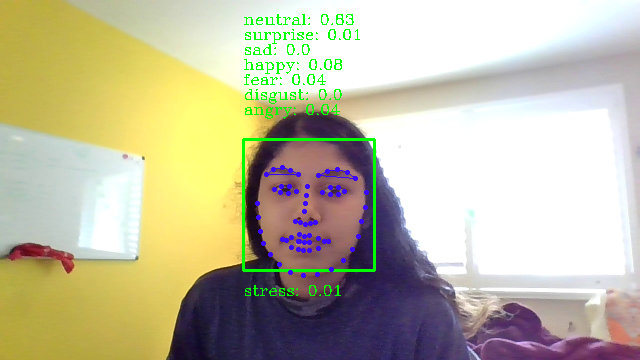

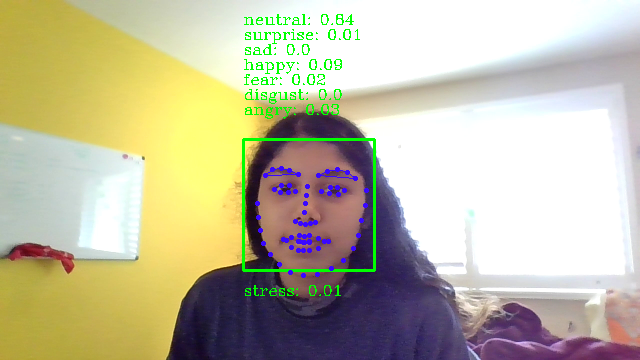

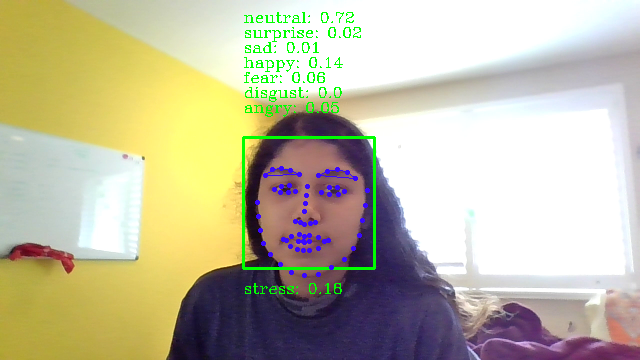

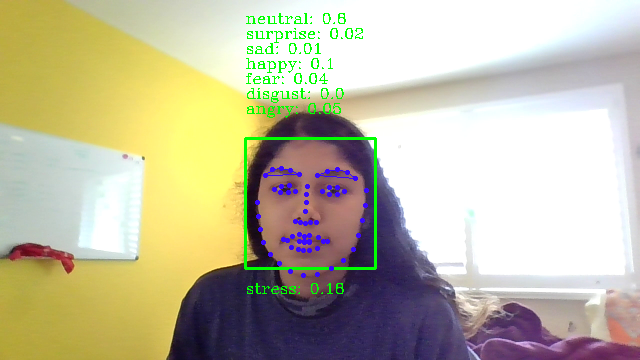

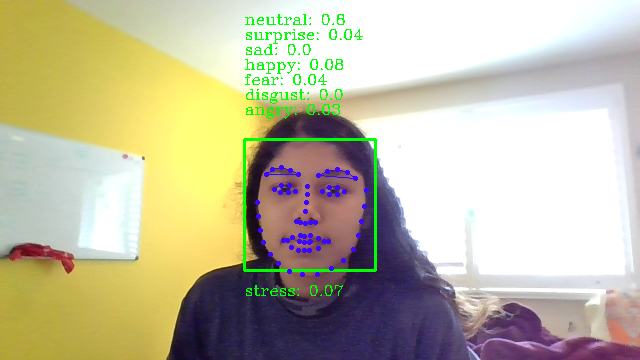

...

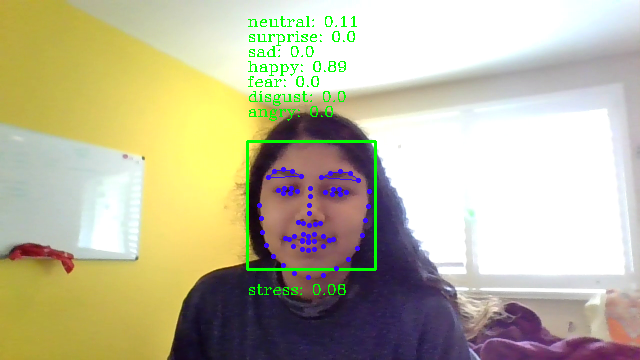

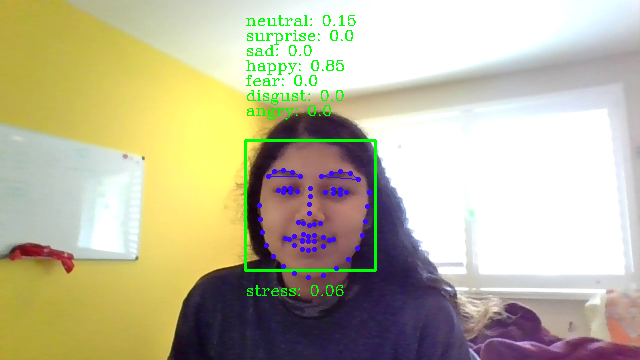

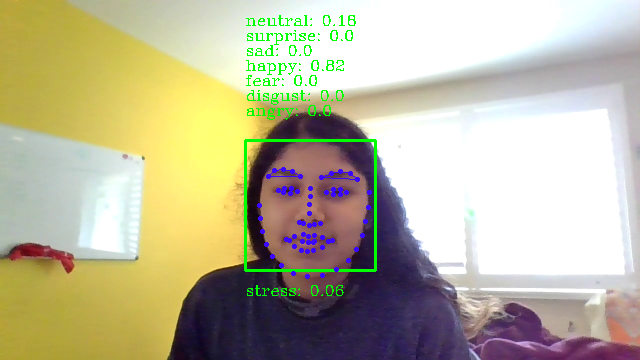

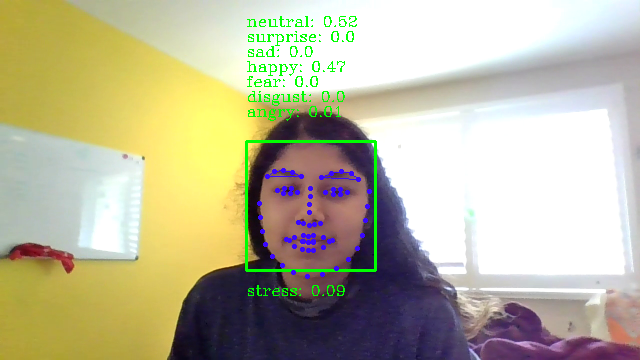

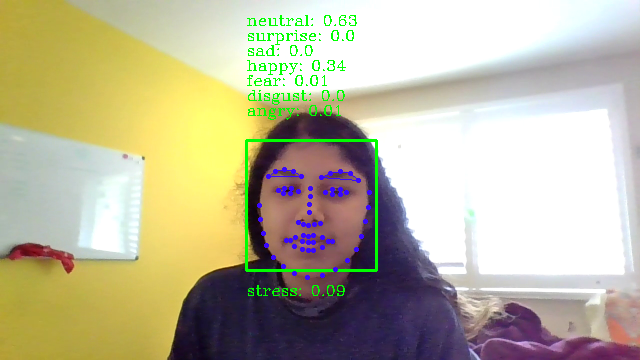

In [ ]:
  while (True):
      ret, test_img = cap.read()  # captures frame and returns boolean value and captured image
      #input_setting = 0
      if not ret:
          continue
      current_frame += 1
      total_frames += 1

      #cv2_imshow(test_img)
      #test_img = cv2.flip(test_img, 1)
      image_h, image_w, image_l = test_img.shape
      test_img = cv2.resize(test_img, (int(image_w/2), int(image_h/2)))
      # test_img_dlib = cv2.resize(test_img, (500, 300))
      # test_img = imutils.resize(test_img, width=500, height=500)
      stress_value = 0
      detector.detect_emotions(test_img)
      if len(detector.emotions) > 0:
          cv2.rectangle(test_img,
                        (detector.emotions[0]['box'][0], detector.emotions[0]['box'][1]),
                        (detector.emotions[0]['box'][0] + detector.emotions[0]['box'][2],
                        detector.emotions[0]['box'][1] + detector.emotions[0]['box'][3]),
                        main_color,
                        2)

          gray_test_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)
          all_faces = dlib_detector(gray_test_img, 0)
          if len(all_faces) > 0:
              face = all_faces[0]
              # cv2.rectangle(test_img, (x, y), (x + w, y + h), (254, 89, 194), 2)
              # cropped_img = test_img[y - 50:y + h + 50, x - 50:x + w + 50]
              # cv2.imshow('cropped image', cropped_img)

              (lBegin, lEnd) = face_utils.FACIAL_LANDMARKS_IDXS["right_eyebrow"]
              (rBegin, rEnd) = face_utils.FACIAL_LANDMARKS_IDXS["left_eyebrow"]
              shape = dlib_predictor(test_img, face)
              for i in range(1, 68):  # There are 68 landmark points on each face
                  # For each point, draw a red circle with thickness 1 on the original frame
                  cv2.circle(test_img, (shape.part(i).x, shape.part(i).y), 1, secondary_color, thickness=2)
              shape = face_utils.shape_to_np(shape)
              leyebrow = shape[lBegin:lEnd]
              reyebrow = shape[rBegin:rEnd]

              reyebrowhull = cv2.convexHull(reyebrow)
              leyebrowhull = cv2.convexHull(leyebrow)

              cv2.drawContours(test_img, [reyebrowhull], -1, secondary_color, 1)
              cv2.drawContours(test_img, [leyebrowhull], -1, secondary_color, 1)

              distq = eye_brow_distance(leyebrow[-1], reyebrow[0])
              stress_value = normalize_values(dlib_points, distq)

          stress_level = ((stress_value + detector.emotions[0]['emotions']['sad'] + detector.emotions[0]['emotions'][
                  'angry'] + detector.emotions[0]['emotions']['fear'] + detector.emotions[0]['emotions'][
                        'disgust']) / 6)
          for i, emotion in enumerate(detector.emotions[0]['emotions']):
              cv2.putText(test_img,
                          f"{emotion}: {detector.emotions[0]['emotions'][emotion]}",
                          (detector.emotions[0]['box'][0], detector.emotions[0]['box'][1] - i*15 - 25), font,
                          0.5, main_color, 1)
              cv2.putText(test_img, f"stress: {round(stress_level,2)}", (detector.emotions[0]['box'][0], (detector.emotions[0]['box'][1]+detector.emotions[0]['box'][3]) + 25), font,
                          0.5, main_color, 1)
              for x, emotion_item in enumerate(data_dict["emotion_data"]["development"]):
                  if data_dict["emotion_data"]["development"][x]["name"] == emotion:
                      data_dict["emotion_data"]["development"][x]["data"].append(int(detector.emotions[0]['emotions'][emotion] * 100))
          data_dict["emotion_data"]["development"][0]["data"].append(
              int(stress_level * 100)
          )
      else:
          for x, item in enumerate(data_dict["emotion_data"]["development"]):
              data_dict["emotion_data"]["development"][x]["data"].append(-1)
          cv2.putText(test_img, f"No detection", (5, 25), font,
                      0.5, main_color, 1)

      #resized_img = cv2.resize(test_img, (1000, 700))
      #img = cv2.imread(test_img, cv2.IMREAD_UNCHANGED)
      cv2_imshow(test_img)
      key = cv2.waitKey(1) & 0xFF
      if key == ord('q'):
          break
      if current_frame == stop_at:
          break


# Face/Smile detection

In [ ]:
# JavaScript to properly create our live video stream using our webcam as input
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

In [ ]:
# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [ ]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

In [ ]:
# initialize the Haar Cascade face detection model
face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'))
#face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_smile.xml'))

In [ ]:

# start streaming video from webcam
video_stream()
# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''
count = 0 
while True:
    js_reply = video_frame(label_html, bbox)
    if not js_reply:
        break

    # convert JS response to OpenCV Image
    img = js_to_image(js_reply["img"])

    # create transparent overlay for bounding box
    bbox_array = np.zeros([480,640,4], dtype=np.uint8)

    # grayscale image for face detection
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # get face region coordinates
    faces = face_cascade.detectMultiScale(gray)
    # get face bounding box for overlay
    for (x,y,w,h) in faces:
      bbox_array = cv2.rectangle(bbox_array,(x,y),(x+w,y+h),(255,0,0),2)

    bbox_array[:,:,3] = (bbox_array.max(axis = 2) > 0 ).astype(int) * 255
    # convert overlay of bbox into bytes
    bbox_bytes = bbox_to_bytes(bbox_array)
    # update bbox so next frame gets new overlay
    bbox = bbox_bytes

<IPython.core.display.Javascript object>

# Data generation

In [ ]:
cv2.destroyAllWindows()
cap.release()


In [ ]:
intervals_total = (current_frame / (frame_rate*capture_interval))

In [ ]:
print(f"total frames: {total_frames}")
print(f"total captured frames: {current_frame}")
print(f"total captured intervals: {intervals_total}")
for x, item in enumerate(data_dict["emotion_data"]["development"]):
    print(f"total data points: {len(data_dict['emotion_data']['development'][x]['data'])}")


total frames: 100
total captured frames: 100
total captured intervals: 1.6666666666666667
total data points: 100
total data points: 100
total data points: 100
total data points: 100
total data points: 100
total data points: 100
total data points: 100
total data points: 100


In [ ]:
for x, cur_emotion in enumerate(data_dict["emotion_data"]["development"]):
    total_emotion = 0
    frames_of_no_emotion = 0
    for i in range(len(data_dict["emotion_data"]["development"][x][f"data"])):
        if data_dict["emotion_data"]["development"][x]["data"][i] != -1:
            total_emotion += data_dict["emotion_data"]["development"][x]["data"][i]
        else:
            frames_of_no_emotion += 1
        if i % (frame_rate*capture_interval) == 0 and i != 0:
            data_dict["emotion_data"][f"avg_{data_dict['emotion_data']['development'][x]['name']}_timeline"].append(round(total_emotion/(i-frames_of_no_emotion), 2))
            frames_of_no_emotion = 0
    data_dict["emotion_data"][f"overall_{data_dict['emotion_data']['development'][x]['name']}"] = round(total_emotion / (len(data_dict["emotion_data"]["development"][x]["data"])-data_dict["emotion_data"]["development"][x]["data"].count(-1)), 2)


In [ ]:
print(data_dict["emotion_data"]["development"][0]["data"])
if not os.path.exists("emotion_result1.json"):
    with open('emotion_result.json', 'w') as json_file:
        json.dump({"sessions": [data_dict]}, json_file)
else:
    with open('emotion_result.json', 'w+') as json_file:
        json_data = json.load(json_file)
        for i, item in enumerate(json_data["sessions"]):
            if json_data["sessions"][i]["session_date"] == session_date:
                json_data["sessions"][i] = data_dict
        json.dump(json_data, json_file)


[1, 0, 18, 18, 7, 7, 8, 12, 10, 8, 9, 10, 9, 11, 10, 10, 13, 11, 9, 9, 9, 13, 12, 9, 12, 12, 12, 9, 12, 8, 6, 6, 8, 11, 8, 8, 8, 8, 8, 5, 6, 8, 8, 6, 5, 6, 8, 8, 6, 8, 6, 8, 6, 6, 6, 6, 8, 6, 6, 8, 6, 6, 6, 6, 6, 8, 6, 8, 6, 8, 11, 6, 8, 11, 8, 8, 8, 8, 6, 11, 8, 8, 6, 8, 8, 6, 6, 8, 8, 8, 8, 6, 8, 6, 8, 8, 6, 6, 8, 8]


Text(0.5, 1.0, 'Happy Level Analysis Over Session Time')

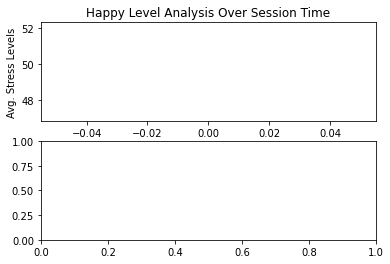

In [ ]:
fig, (ax1, ax2) = plt.subplots(2)
ax1.plot(range(len(data_dict["emotion_data"]["avg_happy_timeline"])), data_dict["emotion_data"]["avg_happy_timeline"])
ax1.set(xlabel=f"Session Duration ({capture_interval} second intervals)", ylabel="Avg. Stress Levels")
ax1.set_title(f"Happy Level Analysis Over Session Time")


In [ ]:
ax2.plot(range(len(data_dict["emotion_data"]["development"][0]["data"])), data_dict["emotion_data"]["development"][0]["data"])
ax2.set(xlabel="Session Duration (frames)", ylabel="Stress Levels")
ax2.set_title("Stress Level Analysis Over Session Time (in Frames)")

plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>